In [4]:
!pip install audio_dspy

In [1]:
import sys
sys.path.append('/home/paulkendrick/clarity_CEC1/env/lib/python3.6/site-packages')
# ls /home/paulkendrick/clarity_CEC1/env/lib/python3.6/site-packages/audio_dspy
import audio_dspy as adsp
import numpy as np


In [31]:
audiogram_cfs =  [
      250,
      500,
      1000,
      2000,
      3000,
      4000,
      6000,
      8000
    ]
audiogram_levels_l = [
      45,
      45,
      35,
      45,
      60,
      65,
      70,
      65
    ]
audiogram_levels_r = [
      40,
      40,
      45,
      45,
      60,
      65,
      80,
      80
    ]

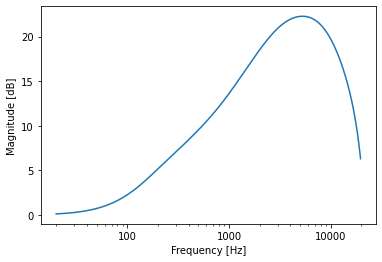

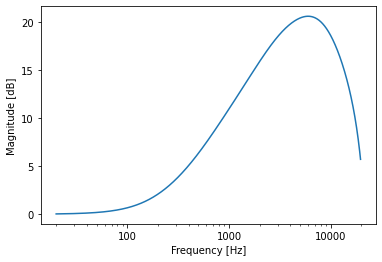

In [5]:
import audio_dspy as adsp
import numpy as np
import matplotlib.pyplot as plt

 # sample rate
def design_eq(audiogram_levels_l, audiogram_levels_r, audiogram_cfs, max_gain = 30, fs = 44100, Q = 0.707):
    # design EQ
    eq_L = adsp.EQ(fs)
    eq_R = adsp.EQ(fs)
    for loss_L, loss_R, fc in zip(audiogram_levels_l, audiogram_levels_r, audiogram_cfs):
        best_L = min(audiogram_levels_l)
        best_R = min(audiogram_levels_r)

        gain_L = np.min((max_gain, loss_L-best_L))
        gain_R = np.min((max_gain, loss_R-best_R))
#         print(gain_L, gain_R)
        eq_L.add_bell(fc, Q, np.power(10,(gain_L/20)))
        eq_R.add_bell(fc, Q, np.power(10,(gain_R/20)))
    return eq_L, eq_R
# plot EQ magnitude response
eq_L, eq_R = design_eq(audiogram_levels_l, audiogram_levels_r, audiogram_cfs, max_gain = 30, fs = 44100, Q = 0.707)
worN = np.logspace(1, 3.3, num=10000, base=20) # frequencies to plot

eq_L.plot_eq_curve(worN=worN)
plt.show()
eq_R.plot_eq_curve(worN=worN)
plt.show()


In [53]:
def compressor_twochannel(x, Fs, T, R, attackTime, releaseTime):
    """
    This function implements a two channel compressor where the
    same scaling is applied to both channels. This function is based on
    the standard MATLAB dynamic range compressor [1] and its "Hack
    Audio" implementation: https://www.hackaudio.com/

    [1] Giannoulis, Dimitrios, Michael Massberg, and Joshua D. Reiss. "Digital
    Dynamic Range Compressor Design: A Tutorial and Analysis." Journal of
    Audio Engineering Society. Vol. 60, Issue 6, 2012, pp. 399-408.


    Args:
        x (ndarray): signal.
        Fs (int): sampling rate.
        T (int): threshold relative to 0 dBFS.
        R (int): compression ratio.
        attackTime (float): attack time in seconds.
        releaseTime (float): release time in seconds.

    Returns:
        ndarray: signal y


    """
    N = len(x)
    channels = np.shape(x)[1]
    if channels != 2:
        raise ValueError("Channel mismatch.")
    y = np.zeros((N, 2))
    lin_A = np.zeros((N, 1))

    # Get attack and release times
    alphaA = np.exp(-np.log(9) / (Fs * attackTime))
    alphaR = np.exp(-np.log(9) / (Fs * releaseTime))

    gainSmoothPrev = 0  # Initialise smoothed gain variable

    # Loop over each sample
    for n in range(N):
        # Derive dB of sample x[n]
        xn_left = np.abs(x[n, 0])
        xn_right = np.abs(x[n, 1])
        xn = max(xn_left, xn_right)
        with np.errstate(divide="ignore"):
            x_dB = 20 * np.log10(np.divide(xn, 1))

        # Ensure there are no values of negative infinity
        if x_dB < -96:
            x_dB = -96

        # Check if sample is above threshold T
        # Static Characteristic - applying hard knee
        if x_dB > T:
            gainSC = T + (x_dB - T) / R  # Perform compression
        else:
            gainSC = x_dB  # No compression

        # Compute the gain change as the difference
        gainChange_dB = gainSC - x_dB

        # Smooth the gain change using the attack and release times
        if gainChange_dB < gainSmoothPrev:
            # Attack
            gainSmooth = ((1 - alphaA) * gainChange_dB) + (alphaA * gainSmoothPrev)
        else:
            # Release
            gainSmooth = ((1 - alphaR) * gainChange_dB) + (alphaR * gainSmoothPrev)

        # Translate the gain to the linear domain
        lin_A[n, 0] = 10 ** (np.divide(gainSmooth, 20))

        # Apply linear amplitude to input sample
        y[n, 0] = lin_A[n, 0] * x[n, 0]
        y[n, 1] = lin_A[n, 0] * x[n, 1]

        # Update smoothed gain
        gainSmoothPrev = gainSmooth

    return y


def get_rms_blocks(data, fs, block_size):

    input_data = data.copy()

    numChannels = input_data.shape[1]
    numSamples = input_data.shape[0]

    overlap = 0.75  # Overlap of 75% of the block duration
    step = 1.0 - overlap  # Step size by percentage

    T = numSamples / fs  # length of the input in seconds
    numBlocks = int(np.round(((T - block_size) / (block_size * step))) + 1)
    block_range = np.arange(0, numBlocks)
    rms = np.zeros(shape=(numChannels, numBlocks))

    for ch in range(numChannels):
        for block in block_range:
            l = int(
                block_size * (block * step) * fs
            )  # Lower bound of integration (in samples)
            u = int(
                block_size * (block * step + 1) * fs
            )  # Upper bound of integration (in samples)
            # Calculate rms
            with np.errstate(divide="ignore"):
                rms[ch, block] = np.sqrt(np.mean(input_data[l:u, ch] ** 2))

    return rms


def crest_factor(x):
    """
    Calculate crest factor using 35 ms block size.

    Args:
        x (array): signal vector

    Returns:
        float: CF is crest factor
        float: CFdB is crest factor in dB

    """

    rms_x = np.sqrt(np.mean(x**2))
    block_size = 0.035
    peaks = get_rms_blocks(x,CONFIG.fs,block_size)
    peak = np.max(abs(peaks))

    CF = peak/rms_x
    CFdB = 20 * np.log10(CF)

    return CF, CFdB, peak

def soft_clip(x, clip_limit=1):
    """Implementation of a cubic soft-clipper
    https://ccrma.stanford.edu/~jos/pasp/Cubic_Soft_Clipper.html
    """
    deg = 3

    maxamp = np.max(abs(x))

    if maxamp < clip_limit:
        return x
    elif maxamp >= clip_limit:
        xclipped = np.where(
            x > clip_limit,
            (deg - 1) / deg,
            np.where(x < -clip_limit, -(deg - 1) / deg, x - x ** deg / deg),
        )
        return xclipped

In [9]:
x = np.random.random((6*44100,2))
eq_L, eq_R = design_eq(audiogram_levels_l, audiogram_levels_r, audiogram_cfs, max_gain = 10, fs = 44100, Q = 0.707)
eq_L.reset()
y_L = eq_L.process_block(x[:,0])
eq_R.reset()

y_R = eq_R.process_block(x[:,1])

print(np.max(y_L), np.max(y_R))

67.15983052205368 43.732276017528015


In [71]:
import IPython.display as ipd
ipd.Audio(y_L, rate=44100) # load a NumPy array


In [10]:
print(np.max(y_L), np.max(y_R))

67.15983052205368 43.732276017528015


In [14]:
np.power(10,-(30/20))

0.03162277660168379

In [15]:
20 * np.log10(30)

29.54242509439325

In [17]:
pip install git+https://github.com/SiggiGue/pyfilterbank.git

  Cloning https://github.com/SiggiGue/pyfilterbank.git to /tmp/pip-req-build-l3dqfs2w
  Running command git clone -q https://github.com/SiggiGue/pyfilterbank.git /tmp/pip-req-build-l3dqfs2w
  Created wheel for pyfilterbank: filename=pyfilterbank-0.0.0-py3-none-any.whl size=67063 sha256=f52750d2f9cf5941a335c76da68e54b912607b9a96584d2f8b914a064d381ddc
  Stored in directory: /tmp/pip-ephem-wheel-cache-mghzravf/wheels/c4/d3/7b/820929bb81dcfe92320c3aaf045e800ed708bb9538bbc17eae
Successfully built pyfilterbank
Note: you may need to restart the kernel to use updated packages.


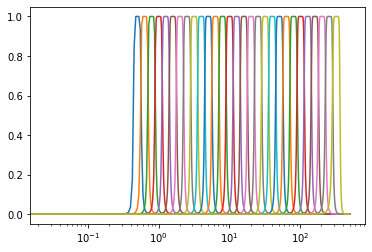

In [8]:
import scipy
import numpy as np
from scipy import signal
from matplotlib import pyplot as plt
def butter_bandpass(lowcut, highcut, fs, order=5, label=None):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    sos = signal.butter(order, [low, high], btype='band', output='sos')
    w, h = signal.sosfreqz(sos,worN=20000)
    plt.semilogx((fs * 0.5 / np.pi) * w, abs(h), label=label)
    return sos

center_freqs = np.array([0.5* 2 ** (n * 1 / 3.) for n in range(0, 29)])
center_freqs.sort()
lower_freqs = 2. ** (-1 / 6.) * center_freqs
for lf in lower_freqs:
    butter_bandpass(lf, lf*2**(1/3.), fs=1000, order=5)

plt.show()


In [9]:
audiogram_cfs =  [
      250,
      500,
      1000,
      2000,
      3000,
      4000,
      6000,
      8000
    ]
audiogram_levels_l = [
      45,
      45,
      35,
      45,
      60,
      65,
      70,
      65
    ]
audiogram_levels_r = [
      40,
      40,
      45,
      45,
      60,
      65,
      80,
      80
    ]

In [10]:
center_freqs = audiogram_cfs
x = np.random.randn((6*44100))
# import soundfile as sf
# x, _ = sf.read("/home/paulkendrick/clarity_CEC1/data_test/clarity_data/dev/scenes/S06001_target.wav")

In [11]:
def eq_signals(
    x_L,
    x_R,
    audiogram_levels_l,
    audiogram_levels_r,
    audiogram_cfs,
    max_gain=30,
    fs=44100,
    window_len=100,
    zero_phase=True,
    verbose=1,
):
    """Hearing aid eq.
    
    Args:
        x_L (numpy array): left ear signal
        x_R (numpy array): right ear signal
        audiogram_levels_l (list): pure tone response level, left ear
        audiogram_levels_r (list): pure tone response level, right ear
        audiogram_cfs (list): center frequencies for the pure tone audiogram
        max_gain (float): maximum gain to apply
        fs(int): sample freq
        window_len (int):
        zero_phase (bool): if true the first window_len //2 samples at the 
            output will be thrown away, making the result zero phase.
            This means the resulting filter looks ahead by window_len //2 samples

    Returns:
        out_L (numpy array): equalised left ear
        out_R (numpy array): equalised right ear
        max_gain_L (float): max gain applied to left ear
        max_gain_R (float): max gain applied to right ear
    """
    gains_L = []
    gains_R = []
    filters = []
    # pad the end of each signal, so that signal can be truncated to same length as input on return
    if zero_phase:
        x_L = np.pad(x_L, [0, window_len//2])
        x_R = np.pad(x_L, [0, window_len//2])
    
    # with an FIR filter low frequencies cannot be effected when filter taps are not long enough
    # filters with a centre freq below this limit are left out of the filter bank
    min_valid_freq = 1/(window_len / fs)
    i_valid_freq_indexes = [n for n, fc in enumerate(audiogram_cfs) if fc > min_valid_freq]
    audiogram_levels_l_ = [audiogram_levels_l[n] for n in i_valid_freq_indexes]
    audiogram_levels_r_ = [audiogram_levels_r[n] for n in i_valid_freq_indexes]
    audiogram_cfs = [audiogram_cfs[n] for n in i_valid_freq_indexes]
    
    # Any gains for filters below this freq limit are collected together into a single value and the powers averaged
    # The averaging incluedes the lower valid frequecy band, this gain value then becomes the gain of the
    # low pass filter in the filter bank.
    # inother words the bottom bands are all condensed into one
    average_power_lower_bands_L = np.mean(np.power(10, np.array(audiogram_levels_l)[0:i_valid_freq_indexes[0]+1] / 10))
    average_power_lower_bands_R = np.mean(np.power(10, np.array(audiogram_levels_r)[0:i_valid_freq_indexes[0]+1] / 10))
    audiogram_levels_l_[0] = 10*np.log10(average_power_lower_bands_L)
    audiogram_levels_r_[0] = 10*np.log10(average_power_lower_bands_R)
    
    # using the audio gram data calculate gain values to apply for each filter 
    # find the pure tone level for the best freq band in each ear
    best_L = min(audiogram_levels_l)
    best_R = min(audiogram_levels_r)
    for loss_L, loss_R, fc in zip(audiogram_levels_l, audiogram_levels_r, audiogram_cfs):
        # the gain to apply. either the difference between the pure tone level and the best pure tone level
        # or if this is greater than the max gain, the max gain.
        gain_L = np.min((max_gain, loss_L-best_L))
        gain_R = np.min((max_gain, loss_R-best_R))
        gains_L.append(gain_L)
        gains_R.append(gain_R)
    
    # build filter bank
    nyq = 0.5 * fs
    # 1st filter is a low pass filter, cut off half way to next filter
    high = (audiogram_cfs[0] + (audiogram_cfs[1] - audiogram_cfs[0])/2) / nyq
    # filter = signal.butter(order, [40/nyq, high], btype='band', output='sos')
    filter = signal.firwin(window_len, [40/nyq, high], pass_zero=False)
    # sos = signal.butter(order, low, btype='low', output='sos')
    filters.append(filter)
    
    # define all band pass filters
    for n in range(1, len(audiogram_cfs)-1):
        fc = audiogram_cfs[n]
        lowcut = fc - (audiogram_cfs[n] - audiogram_cfs[n-1])/2
        highcut = fc + (audiogram_cfs[n+1] - audiogram_cfs[n])/2
        low = lowcut / nyq
        high = highcut / nyq
        # filter = signal.butter(order, [low, high], btype='band', output='sos')
        filter = signal.firwin(window_len, [low, high], pass_zero=False)
        filters.append(filter)
        
    # last filter is high pass
    low = (audiogram_cfs[-2] + (audiogram_cfs[-1] - audiogram_cfs[-2])/2) / nyq
    # filter = signal.butter(order*2, high, btype='high', output='sos')
    filter = signal.firwin(window_len, [low, 0.999], pass_zero=False)
    filters.append(filter)
    
    # filter the signal
    out_L = []
    out_R = []
    if verbose:
        fig1 = go.Figure()
        fig2 = go.Figure()
    for gain_L, gain_R, filter in zip(gains_L, gains_R, filters):
        # filter then apply approprate gain
        y_L = signal.lfilter(filter, 1.0, x_L) * np.power(10, gain_L/20)
        y_R = signal.lfilter(filter, 1.0, x_R) * np.power(10, gain_R/20)
        # y_L = signal.sosfilt(filter, x_L) * np.power(10, gain_L/20)
        # y_R = signal.sosfilt(filter, x_R) * np.power(10, gain_R/20)
        
        if verbose:
            # y_sos = signal.sosfilt(filter, x)
            # w, h = signal.sosfreqz(filter,worN=10000)
            w, h = signal.freqz(filter)
            fig1.add_trace(go.Scatter(x=w, y=20*np.log10(abs(h* np.power(10, gain_L/20)))))
            fig2.add_trace(go.Scatter(x=w, y=20*np.log10(abs(h* np.power(10, gain_R/20)))))
        
        out_L.append(y_L)
        out_R.append(y_R)
    if verbose:
        fig1.show()
        fig2.show()
    # reconstruct broadband signal
    out_L = np.sum(out_L,0)
    out_R = np.sum(out_R,0)
    if zero_phase:
        out_L = out_L[window_len//2:]
        out_R = out_R[window_len//2:]
    return out_L, out_R, max(gains_L), max(gains_R) 



In [12]:
# filtered_sig = []
# for sos in filters:
#     y_sos = signal.sosfilt(sos, x)
#     w, h = signal.sosfreqz(sos,worN=10000)
#     plt.semilogx((fs * 0.5 / np.pi) * w, abs(h)**2)
#     filtered_sig.append(y_sos)



In [15]:
window_len = int(5e-3 * 44100)
window_len = int(10/16000 *  44100) * 2

out_L, out_R, _, _ = eq_signals(x, x, audiogram_levels_l, audiogram_levels_r, audiogram_cfs, max_gain = 10, fs = 44100, window_len = window_len, verbose=1)
# y = np.sum(filtered_sig,0)
# import IPython.display as ipd
# # ipd.Audio(y, rate=44100) # load a NumPy array
# out_L.shape

In [14]:
from plotly import graph_objects as go
fig = go.Figure()

fig.add_trace(go.Scatter(y=x))
fig.add_trace(go.Scatter(y=out_L))

# plt.plot(out_L)
# plt.plot(x)


NameError: name 'out_L' is not defined

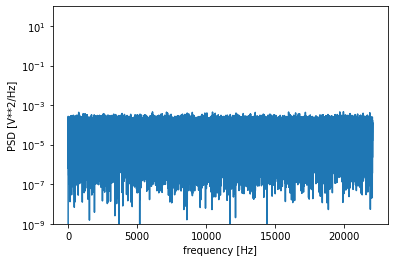

In [171]:
f, Pxx_den = signal.periodogram(x, 44100)
plt.semilogy(f, Pxx_den)
plt.ylim([1e-9, 1e2])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.show()


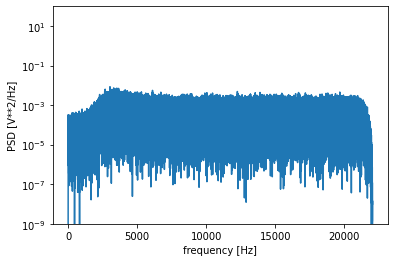

In [172]:
f, Pxx_den = signal.periodogram(out_R, 44100)
plt.semilogy(f, Pxx_den)
plt.ylim([1e-9, 1e2])
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.show()


In [173]:
corr = signal.correlate(out_L, x, mode='full', method='auto')
in2_len = x.shape[0]
in1_len = out_L.shape[0]
lags = np.arange(-in2_len + 1, in1_len)
delay = lags[np.argmax(np.abs(corr))]
delay

0

In [122]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=lags, y=corr))


In [130]:
window_len /44100

0.0012244897959183673

In [131]:
1/0.0012244897959183673

816.6666666666667

In [13]:
x = np.arange(0, 4, 0.01)

In [32]:
import numpy as np
def soft_clip(x, clip_limit=1,deg = 21):
    """Implementation of a cubic soft-clipper
    https://ccrma.stanford.edu/~jos/pasp/Cubic_Soft_Clipper.html
    """
    

    maxamp = np.max(abs(x))

    if maxamp < clip_limit:
        return x
    elif maxamp >= clip_limit:
        xclipped = np.where(
            x > clip_limit,
            (deg - 1) / deg,
            np.where(x < -clip_limit, -(deg - 1) / deg, x - x ** deg / deg),
        )
        return xclipped

def soft_clip(x, deg=3):
    """Implementation of a cubic soft clipper
    Parameters
    ----------
    x: {float, ndarray}
        input to the soft clipper
    deg: int, optional
        polynomial degree of the soft clipper
    Returns
    -------
    y: {float, ndarray}
        output of the soft clipper
    """
    assert deg % 2 == 1, "Degree must be odd integer"

    return np.where(x > 1, (deg-1)/deg,
                    np.where(x < -1, -(deg-1)/deg, x - x**deg/deg))

In [34]:
y = soft_clip(x,deg=21)
from plotly import graph_objects as go
fig = go.Figure()

fig.add_trace(go.Scatter(y=x))
fig.add_trace(go.Scatter(y=y))



In [40]:
fs = 16000
low = 10/ (fs/2)
high = 1500 / (fs/2)
window_len = 11
filter = signal.firwin(window_len, [low, high], pass_zero=False)
fig = go.Figure()
w, h = signal.freqz(filter)
fig.add_trace(go.Scatter(x=w/(2*np.pi)*16000, y=20*np.log10(abs(h))))

low = 1500/ (fs/2)
high = 2500 / (fs/2)

filter = signal.firwin(window_len, [low, high], pass_zero=False)
w, h = signal.freqz(filter)
fig.add_trace(go.Scatter(x=w/(2*np.pi)*16000, y=20*np.log10(abs(h))))
